In [1]:
import numpy as np
from scipy.io import wavfile
from scipy.signal import find_peaks
import matplotlib.pyplot as plt

In [2]:
MUSIC_PATH = './samples/Imagine_Dragons_-_Believer.wav'

In [3]:
import librosa

In [4]:
y , sr = librosa.load(MUSIC_PATH, sr=44100)

In [5]:
y

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

In [6]:
sr

44100

In [7]:
seconds = len(y) / sr
seconds

204.38204081632654

In [8]:
import IPython.display as ipd
ipd.Audio(MUSIC_PATH)

### Определяем биты

In [9]:
tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
y_beats = librosa.clicks(frames=beats, sr=sr, length=len(y))
beat_song = 0.5 * y + 0.5 * y_beats
scaled = np.int16(beat_song / np.max(np.abs(beat_song)) * 32767)
wavfile.write('beat_signal.wav', sr, scaled)

In [10]:
def define_seconds_of_beat(y, sr):
    tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
    return librosa.frames_to_time(beats)

In [11]:
beat_seconds = define_seconds_of_beat(y, sr)

### Определяем сегменты мелодии

In [12]:
tempo, beats = librosa.beat.beat_track(y=y, sr=sr, hop_length=512)
beat_times = librosa.frames_to_time(beats, sr=sr, hop_length=512)
cqt = np.abs(librosa.cqt(y, sr=sr, hop_length=512))
subseg = librosa.segment.subsegment(cqt, beats, n_segments=2)
y_melody = librosa.clicks(frames=subseg, sr=sr, length=len(y))
melody_song = 0.5 * y + 0.5 * y_melody
scaled = np.int16(melody_song / np.max(np.abs(melody_song)) * 32767)
wavfile.write('melody_signal.wav', sr, scaled)

In [13]:
def define_seconds_of_melody(y, sr):
    tempo, beats = librosa.beat.beat_track(y=y, sr=sr, hop_length=512)
    beat_times = librosa.frames_to_time(beats, sr=sr, hop_length=512)
    cqt = np.abs(librosa.cqt(y, sr=sr, hop_length=512))
    subseg = librosa.segment.subsegment(cqt, beats, n_segments=3)
    subseg_t = librosa.frames_to_time(subseg, sr=sr, hop_length=512)
    return subseg_t

### Определяем интенсивные моменты

In [14]:
FRAME_SIZE = 1024
HOP_LENGTH = 512

def amplitude_envelope(y, frame_size, hop_length):
    amplitude_envelope = []
    for i in range(0, len(y), hop_length):
        current_frame_amplitude_envelope = max(y[i:i+frame_size])
        amplitude_envelope.append(current_frame_amplitude_envelope)
    return np.array(amplitude_envelope)

In [15]:
ae = amplitude_envelope(y, FRAME_SIZE, HOP_LENGTH)

In [16]:
frames = range(0, ae.size)
t = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

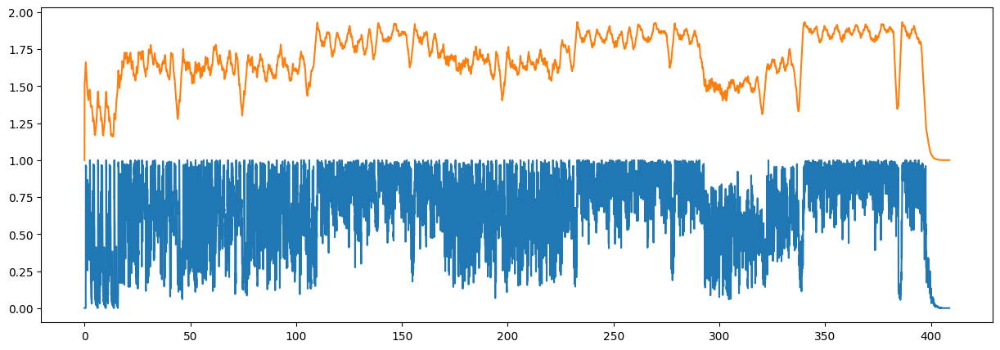

In [17]:
import collections
from itertools import islice

def sliding_window(iterable, n):
    "Collect data into overlapping fixed-length chunks or blocks."
    # sliding_window('ABCDEFG', 4) --> ABCD BCDE CDEF DEFG
    it = iter(iterable)
    window = collections.deque(islice(it, n-1), maxlen=n)
    for x in it:
        window.append(x)
        yield tuple(window)

plt.figure(figsize=(15,5))
plt.plot(t, ae)
mean_arr = [0]
n = 100
for elems in sliding_window(ae, n):
    mean_arr.append(np.mean(elems))
mean_arr.extend([0] * (n-2))
mean_arr = np.array(mean_arr)
mean_arr += 1
plt.plot(t, mean_arr)

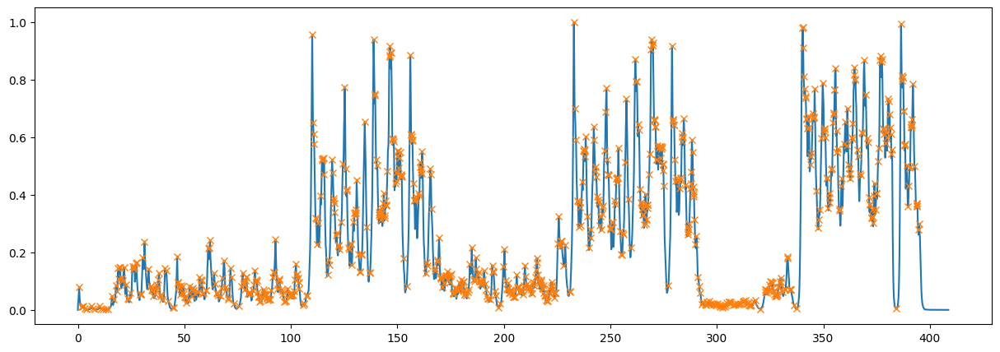

In [18]:
plt.figure(figsize=(15,5))
# plt.plot(t, mean_arr)
volume = np.power(10000, mean_arr)
mean_vol = [0]
n = 3
for elems in sliding_window(volume, n):
    mean_vol.append(np.mean(elems))
mean_vol.extend([0] * (n-2))
mean_vol = np.array(mean_vol)
normalized_vol = np.abs(mean_vol / np.max(mean_vol))
plt.plot(t, normalized_vol)
peaks, _ = find_peaks(normalized_vol)
peaks_t = librosa.frames_to_time(peaks)
plt.plot(peaks_t, normalized_vol[peaks], "x")

In [19]:
y_new = []
for t_new in np.linspace(t[0], t[-1], num=len(y)):
    y_new.append(np.interp(t_new, t, normalized_vol))

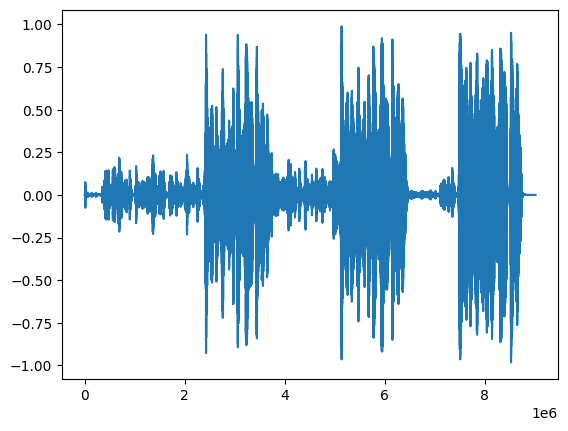

In [20]:
y_new = np.array(y_new)
plt.plot(y_new * y)
scaled = np.int16(y_new * y / np.max(np.abs(y_new * y)) * 32767)
wavfile.write('sample_with_vol_scaling.wav', sr, scaled)